## 1. Imports

In [1]:
import os, sys
sys.path.append("..")

import math
import matplotlib
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline 

import numpy as np
import pandas as pd
import torch
import torch.nn as nn
import torchvision
import gc
import pdb

from src import distributions
import torch.nn.functional as F

from src.resnet2 import ResNet_D
# from src.resnet_generator import ResnetGenerator
from src.cunet import CUNet

from src.tools import unfreeze, freeze
from src.tools import load_dataset, get_sde_pushed_loader_stats
from src.fid_score import calculate_frechet_distance
from src.tools import weights_init_D
from src.plotters import plot_random_sde_images, plot_fixed_sde_images, plot_fixed_sde_trajectories, plot_random_sde_trajectories, plot_several_fixed_sde_trajectories, plot_several_random_sde_trajectories
from src.anime_benchmark import get_anime_benchmark

from collections import defaultdict
from copy import deepcopy
import json

from tqdm import tqdm_notebook as tqdm
from IPython.display import clear_output

import wandb
from src.tools import fig2data, fig2img # for wandb

# This needed to use dataloaders for some datasets
from PIL import PngImagePlugin
LARGE_ENOUGH_NUMBER = 100
PngImagePlugin.MAX_TEXT_CHUNK = LARGE_ENOUGH_NUMBER * (1024**2)

In [2]:
gc.collect(); torch.cuda.empty_cache()

## 2. Config

Dataset choosing in the first rows

In [3]:
EPSILON = 0.1
EPS = EPSILON

# N steps in the Euler-Maruyama
N_STEPS = 10

# GPU choosing
DEVICE_IDS = [0]
BENCHMARK_DEVICE_ID = 0

# All hyperparameters below is set to the values used for the experiments, which discribed in the article

T_ITERS = 10
D_LR, T_LR = 1e-4, 1e-4
IMG_SIZE = 64
UNET_BASE_FACTOR = 48

TIME_DIM = 128
# CONSTANT_TIME = False
USE_POSITIONAL_ENCODING = True
# RESNET_GENERATOR = False
INTEGRAL_SCALE = 1/(3*IMG_SIZE*IMG_SIZE)
# ONE_STEP_INIT_ITERS = 0
T_GRADIENT_MAX_NORM = float("inf")
D_GRADIENT_MAX_NORM = float("inf")
PREDICT_SHIFT = False
# SMART_INTERVALS = False
# INTERVAL_SHRINK_START_TIME = 0.98
# LAST_STEP_NOISE_STD = 1e-3
USE_GRADIENT_CHECKPOINT = False
PREDICT_NOISE_AT_LAST_STEP = False
# N_LAST_STEPS_WITHOUT_NOISE = 1
TRACK_VAR_INTERVAL = 10
# IMPROVED_DIFFUSION = False
# USE_CHECKPOINTS_INSIDE_MODEL = False
EPSILON_SCHEDULER_LAST_ITER = 20000
# USE_EXPONENTIAL_AVERAGE_MODEL = False
DISTINCT_SHIFT_MODELS = False

GPU_DEVICE = 0
DATASET1_CHANNELS = 3
DATASET2_CHANNELS = 3
GRAY_PLOTS = False
BATCH_SIZE = 16
STEPS_TO_SHOW = 10

PLOT_INTERVAL = 500
COST = 'schrodinger'
CPKT_INTERVAL = 500
WANDB_CHECKPOINTS_SAVE = 5000
MAX_STEPS = 100001
SEED = 0xBADBEEF

GAMMA0, GAMMA1 = 0.0, 0.333
GAMMA_ITERS = 20000

CONTINUE = -1

In [4]:
EXP_NAME = f'ENOT_ANIME_T{T_ITERS}_DISTINCT_SHIFT_MODELS_{DISTINCT_SHIFT_MODELS}_PREDICT_SHIFT_{PREDICT_SHIFT}_BASE_FACTOR_{UNET_BASE_FACTOR}_STEPS_{N_STEPS}_EPSILON_{EPSILON}_IMG_SIZE{IMG_SIZE}'
OUTPUT_PATH = '../checkpoints/{}/{}/{}/'.format(COST, EXP_NAME, IMG_SIZE)

In [5]:
config = dict(
    SEED=SEED,
    T_ITERS=T_ITERS,
    D_LR=D_LR, T_LR=T_LR,
    BATCH_SIZE=BATCH_SIZE,
    UNET_BASE_FACTOR=UNET_BASE_FACTOR,
    N_STEPS=N_STEPS,
    EPSILON=EPSILON,
    USE_POSITIONAL_ENCODING=USE_POSITIONAL_ENCODING,
    TIME_DIM=TIME_DIM,
    INTEGRAL_SCALE=INTEGRAL_SCALE,
    T_GRADIENT_MAX_NORM=T_GRADIENT_MAX_NORM,
    D_GRADIENT_MAX_NORM=D_GRADIENT_MAX_NORM,
    PREDICT_SHIFT=PREDICT_SHIFT,
    USE_GRADIENT_CHECKPOINT=USE_GRADIENT_CHECKPOINT,
    PREDICT_NOISE_AT_LAST_STEP=PREDICT_NOISE_AT_LAST_STEP,
    EPSILON_SCHEDULER_LAST_ITER=EPSILON_SCHEDULER_LAST_ITER,
    DISTINCT_SHIFT_MODELS=DISTINCT_SHIFT_MODELS,
)

FID_EPOCHS = 1
    
assert torch.cuda.is_available()
torch.cuda.set_device(f'cuda:{DEVICE_IDS[0]}')
torch.manual_seed(SEED); np.random.seed(SEED)

if not os.path.exists(OUTPUT_PATH):
    os.makedirs(OUTPUT_PATH)

## 3. Loading stats for FID calculations

In [6]:
filename = f'../stats/Anime_Y_test_eps_{EPS}.json'
with open(filename, 'r') as fp:
    data_stats = json.load(fp)
    mu_data, sigma_data = data_stats['mu'], data_stats['sigma']
del data_stats

## 4. Prepare Samplers (X, Y)

In [7]:
benchmark = get_anime_benchmark(batch_size=20, eps=EPS,
                                glow_device=f"cuda:{BENCHMARK_DEVICE_ID}",
                                samples_device=f"cuda",
                                download=False)

X_sampler = benchmark.X_sampler
X_test_sampler = benchmark.X_test_sampler

Y_sampler = benchmark.Y_sampler
Y_test_sampler = benchmark.Y_test_sampler

../src/model.py:102: UserWarning: The given NumPy array is not writeable, and PyTorch does not support non-writeable tensors. This means you can write to the underlying (supposedly non-writeable) NumPy array using the tensor. You may want to copy the array to protect its data or make it writeable before converting it to a tensor. This type of warning will be suppressed for the rest of this program. (Triggered internally at  /pytorch/torch/csrc/utils/tensor_numpy.cpp:141.)
  w_s = torch.from_numpy(w_s)


## 5. Code for models

In [8]:
class Swish(nn.Module):
    def __init__(self):
        super().__init__()

    def forward(self, input):
        return F.silu(input)


class TimeEmbedding(nn.Module):
    def __init__(self, dim, scale):
        super().__init__()

        self.dim = dim
        self.scale = scale

        inv_freq = torch.exp(
            torch.arange(0, dim, 2, dtype=torch.float32) * (-math.log(10000) / dim)
        )

        self.register_buffer("inv_freq", inv_freq)

    def forward(self, input):
        shape = input.shape
        
        input = input*self.scale + 1
        sinusoid_in = torch.ger(input.view(-1).float(), self.inv_freq)
        pos_emb = torch.cat([sinusoid_in.sin(), sinusoid_in.cos()], dim=-1)
        pos_emb = pos_emb.view(*shape, self.dim)

        return pos_emb


class SDE(nn.Module):
    def __init__(self, shift_model, epsilon, n_steps, time_dim, times):
        super().__init__()
        self.shift_model = shift_model
        self.epsilon = epsilon
        self.n_steps = n_steps
        self.times = times
        self.time_to_step = {str(round(time, 3)): i for i, time in enumerate(times)}
        
        self.time = nn.Sequential(
            TimeEmbedding(time_dim, scale=n_steps),
            nn.Linear(time_dim, time_dim),
            Swish(),
            nn.Linear(time_dim, time_dim),
        )
    
    def forward(self, x0):            
        t0 = 0.0
        trajectory = [x0]
        times = [t0]
        shifts = []

        x, t = x0, t0

        for i, t_next in enumerate(self.times[1:]):

            if i >= len(self.times[1:]) - 1:
                x, shift = self._step(x, t, t_next - t, add_noise=False)
            else:
                x, shift = self._step(x, t, t_next - t, add_noise=True)

            t = t_next

            trajectory.append(x)
            times.append(t)
            shifts.append(shift)

        trajectory = torch.stack(trajectory, dim=1)
        times = torch.tensor(times)[None, :].repeat(trajectory.shape[0], 1).cuda()
        shifts = torch.stack(shifts, dim=1)

        return trajectory, times, shifts
    
    def _step(self, x, t, delta_t, add_noise=True):
        if PREDICT_SHIFT:
            shift_dt = self._get_shift(x, t)
            shifted_x = x + shift_dt
            shift = shift_dt/(torch.tensor(delta_t).cuda())
        else:
            shifted_x = self._get_shift(x, t)
            shift = (shifted_x - x)/(torch.tensor(delta_t).cuda())
        noise = self._sample_noise(x, delta_t)
        
        if add_noise:
            return shifted_x + noise, shift
        
        return shifted_x, shift
    
    def _get_shift(self, x, t):
        batch_size = x.shape[0]
        
        if DISTINCT_SHIFT_MODELS:
            step = self.time_to_step[str(round(t, 3))]
            t = torch.tensor(0.0).repeat(batch_size)[:, None, None, None].cuda()
            return self.shift_model[step](x, t)
        elif USE_POSITIONAL_ENCODING:
            t = torch.tensor(t).repeat(batch_size)
            t = t.cuda()
            t = self.time(t)
            t = t[:, :, None, None]
        else:
            t = torch.tensor(t).repeat(batch_size)[:, None, None, None]
            if x.device.type == "cuda":
                t = t.cuda()
        
        if USE_GRADIENT_CHECKPOINT:
            return torch.utils.checkpoint.checkpoint(self.shift_model, x, t)
        
        return self.shift_model(x, t)
        
    def _sample_noise(self, x, delta_t):
        noise = math.sqrt(self.epsilon)*math.sqrt(delta_t)*torch.randn(x.shape)
        
        if x.device.type == "cuda":
            noise = noise.cuda()
        return noise
            
    def set_epsilon(self, epsilon):
        self.epsilon = epsilon
        

def integrate(values, times):
    deltas = times[1:] - times[:-1]
    if values.device.type == "cuda":
        deltas = deltas.cuda()
    return (values*deltas[None, :]).sum(dim = 1)


def calculate_noise_norm(dim, n_steps, epsilon):
    n = dim
    dt = 1/n_steps
    sigma = math.sqrt(dt)*math.sqrt(epsilon)

    return n_steps*(math.exp(math.log(sigma) + math.log(math.sqrt(2)) + math.lgamma((n+1)/2) - math.lgamma(n/2)))


def calculate_time_intervals(n_steps):
    times = np.linspace(0, 1, n_steps + 1).tolist()    
    return times


def wdb_save_artifact(name, file_path, art_type):
    art = wandb.Artifact(name, type=art_type)
    art.add_file(file_path)
    wandb.log_artifact(art)

## 6. Training

### Models initialization

In [9]:
D = ResNet_D(IMG_SIZE, nc=DATASET2_CHANNELS).cuda()
D.apply(weights_init_D)

if not USE_POSITIONAL_ENCODING:
    TIME_DIM = 1


if DISTINCT_SHIFT_MODELS:
    T = nn.ModuleList(
        [CUNet(DATASET1_CHANNELS, DATASET2_CHANNELS, 1, base_factor=UNET_BASE_FACTOR).cuda() for i in range(N_STEPS)]
    )
    
else:
    T = CUNet(DATASET1_CHANNELS, DATASET2_CHANNELS, TIME_DIM, base_factor=UNET_BASE_FACTOR).cuda()

times = calculate_time_intervals(N_STEPS)
    
T = SDE(T, EPSILON, len(times) - 1, TIME_DIM, times=times).cuda()

if len(DEVICE_IDS) > 1 and CONTINUE==-1:
    T = nn.DataParallel(T, device_ids=DEVICE_IDS)
    D = nn.DataParallel(D, device_ids=DEVICE_IDS)
    
print(times)
print('T params:', np.sum([np.prod(p.shape) for p in T.parameters()]))
print('D params:', np.sum([np.prod(p.shape) for p in D.parameters()]))

[0.0, 0.1, 0.2, 0.30000000000000004, 0.4, 0.5, 0.6000000000000001, 0.7000000000000001, 0.8, 0.9, 1.0]
T params: 9934611
D params: 22933441


In [10]:
T_opt = torch.optim.Adam(T.parameters(), lr=T_LR, weight_decay=1e-10)
D_opt = torch.optim.Adam(D.parameters(), lr=D_LR, weight_decay=1e-10)
T_scheduler = torch.optim.lr_scheduler.MultiStepLR(T_opt, milestones=[15000, 25000, 40000, 55000, 70000], gamma=0.5)
D_scheduler = torch.optim.lr_scheduler.MultiStepLR(D_opt, milestones=[15000, 25000, 40000, 55000, 70000], gamma=0.5)

if CONTINUE > -1:
    T_opt.load_state_dict(torch.load(os.path.join(OUTPUT_PATH, f'T_opt_{SEED}_{CONTINUE}.pt')))
    T_scheduler.load_state_dict(torch.load(os.path.join(OUTPUT_PATH, f'T_scheduler_{SEED}_{CONTINUE}.pt')))
    
    T.load_state_dict(torch.load(os.path.join(OUTPUT_PATH, f'T_{SEED}_{CONTINUE}.pt')))
    D.load_state_dict(torch.load(os.path.join(OUTPUT_PATH, f'D_{SEED}_{CONTINUE}.pt')))
    
    if len(DEVICE_IDS) > 1:
        T = nn.DataParallel(T, device_ids=DEVICE_IDS)
        D = nn.DataParallel(D, device_ids=DEVICE_IDS)
    
    D_opt.load_state_dict(torch.load(os.path.join(OUTPUT_PATH, f'D_opt_{SEED}_{CONTINUE}.pt')))
    D_scheduler.load_state_dict(torch.load(os.path.join(OUTPUT_PATH, f'D_scheduler_{SEED}_{CONTINUE}.pt')))

In [11]:
torch.manual_seed(0xBADBEEF); np.random.seed(0xBADBEEF)
X_fixed, Y_fixed = X_sampler.sample(10), Y_sampler.sample(10)

X_test_fixed, Y_test_fixed = X_test_sampler.sample(10), Y_test_sampler.sample(10)

In [12]:
wandb.init(name=EXP_NAME, config=config, project="EntropicOTBenchmark")

wandb: Currently logged in as: schrodinger_bridge (use `wandb login --relogin` to force relogin)
wandb: wandb version 0.13.9 is available!  To upgrade, please run:
wandb:  $ pip install wandb --upgrade


### Main training cycle and logging

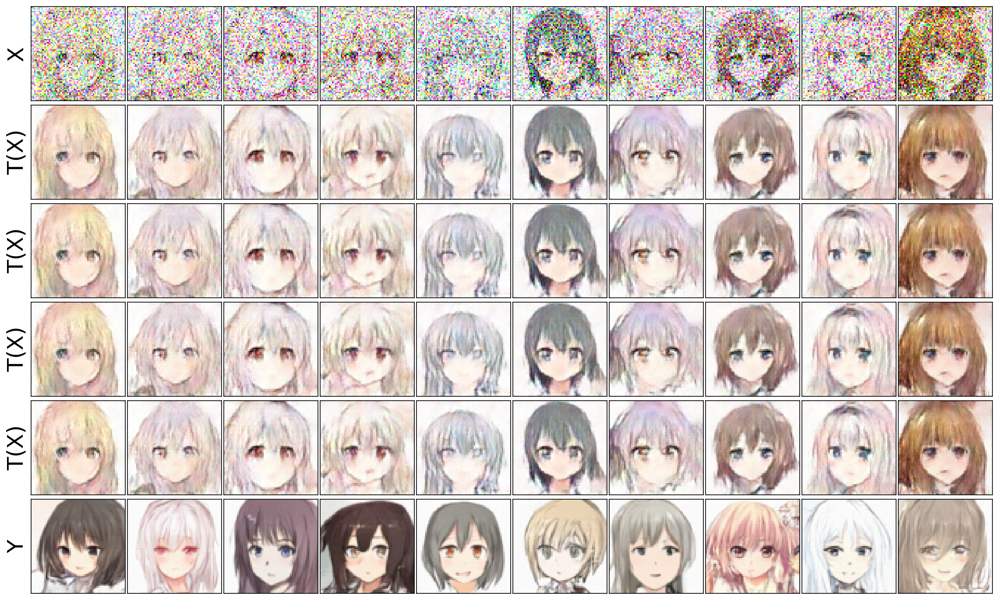

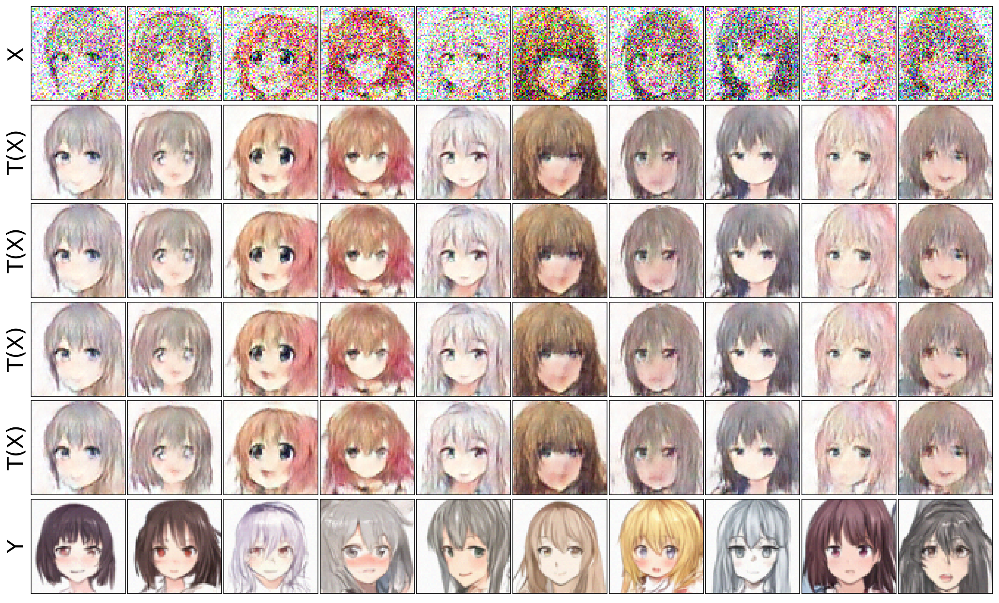

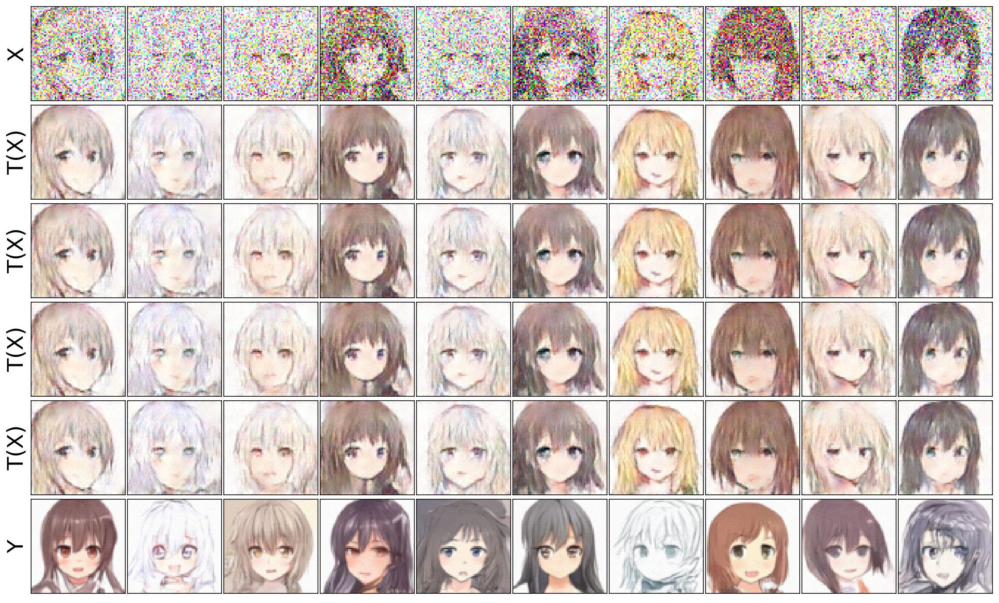

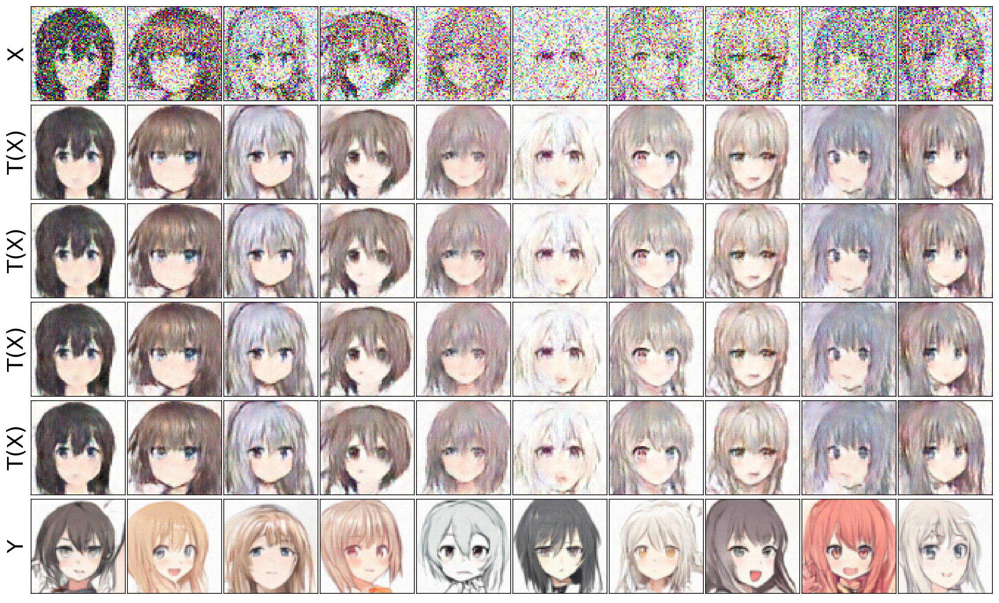

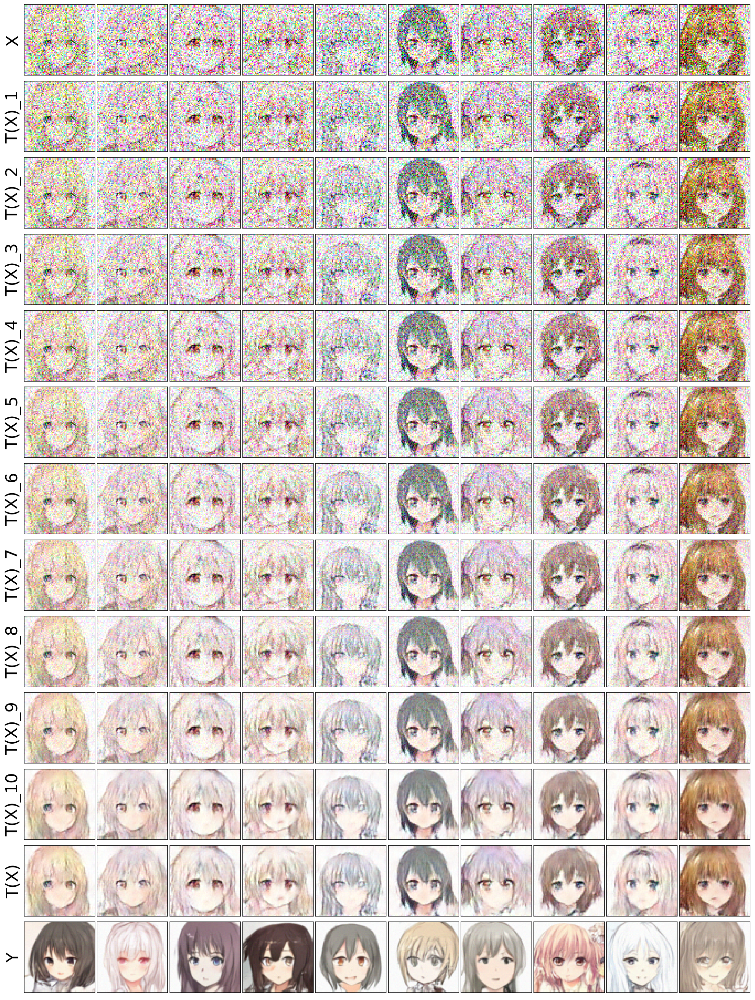

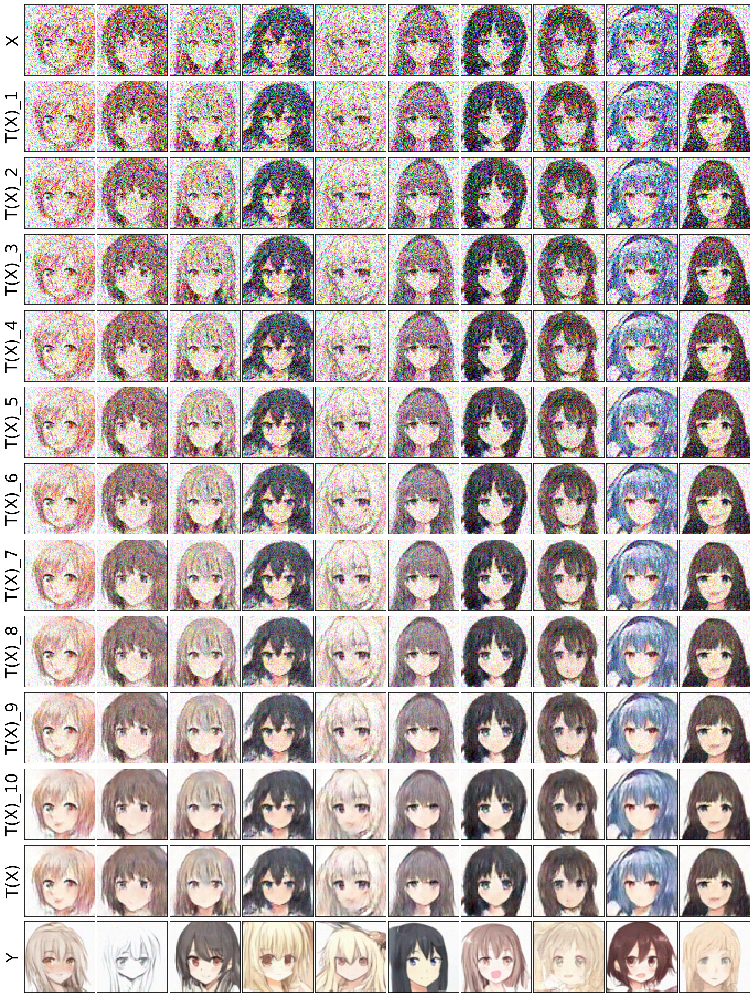

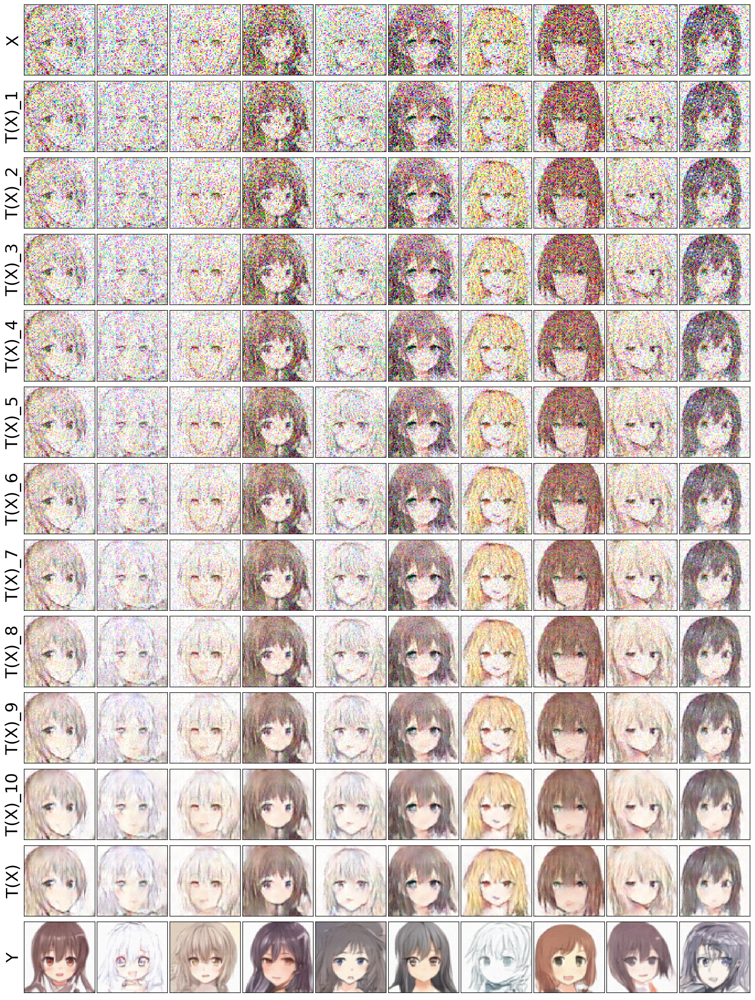

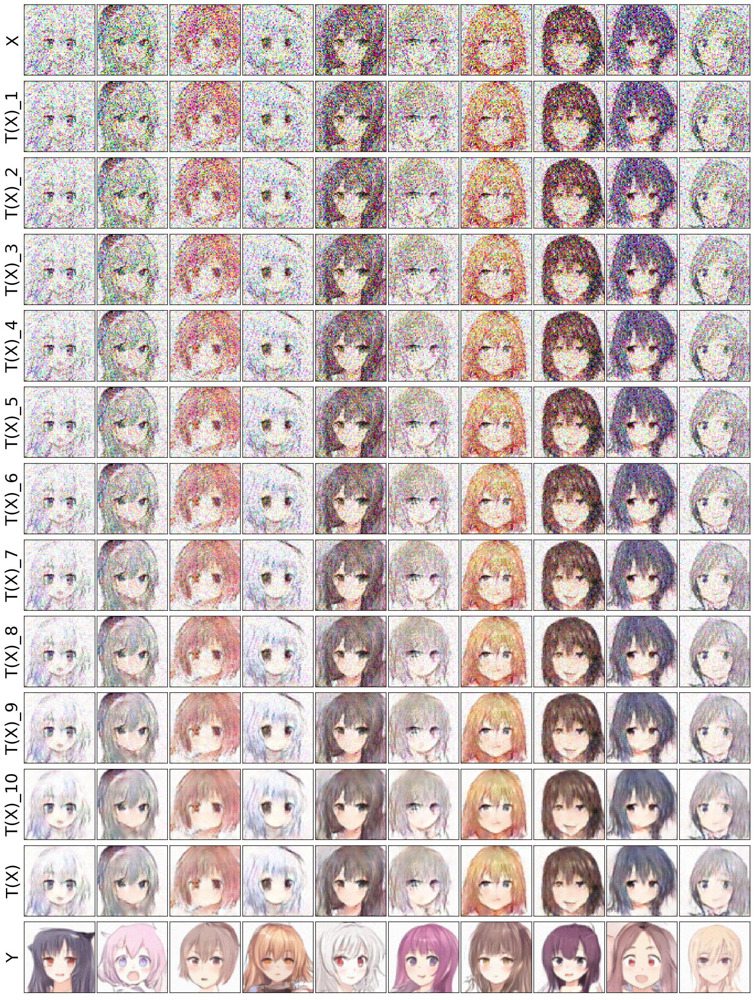

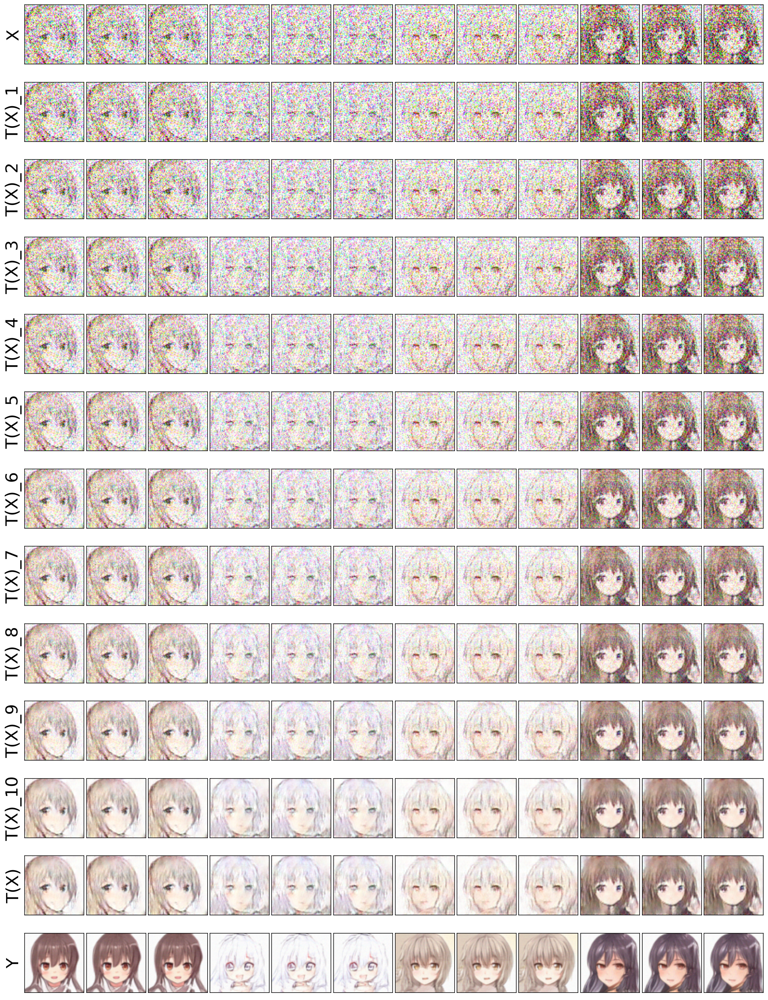

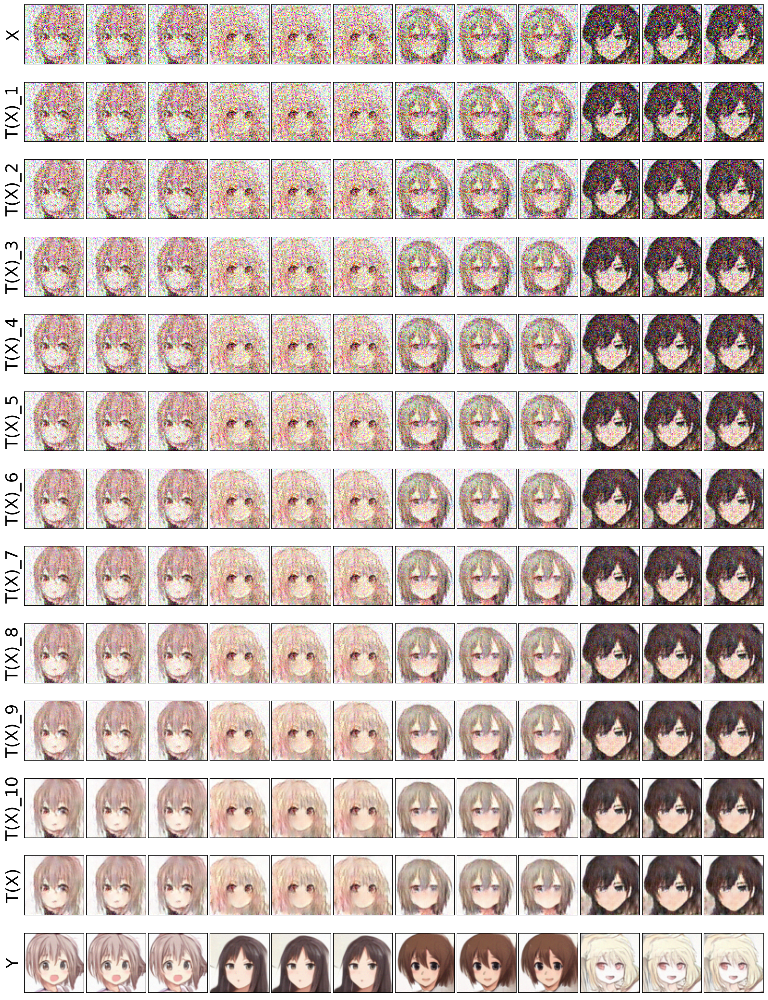

Computing FID


In [ ]:
noise_norm = calculate_noise_norm(3*IMG_SIZE*IMG_SIZE, N_STEPS, EPSILON) if EPSILON > 0 else 0
wandb.log({f'Noise norm' : noise_norm}, step=0)

data = {"time index": [i for i in range(len(times))],
        "time value": [time for time in times]}
df = pd.DataFrame(data)
tbl = wandb.Table(data=df)
wandb.log({"time_table": tbl}, step=0)

TOTAL_STEPS = len(times) - 1
wandb.log({"TOTAL STEPS": len(times) - 1}, step=0)

epsilon_scheduler = lambda step: min(EPSILON, EPSILON*(step/(EPSILON_SCHEDULER_LAST_ITER)))

for step in tqdm(range(CONTINUE + 1, MAX_STEPS)):
    
    unfreeze(T); freeze(D)
    T.train()
    
    new_epsilon = epsilon_scheduler(step)
    if len(DEVICE_IDS) > 1:
        T.module.set_epsilon(new_epsilon)
    else:
        T.set_epsilon(new_epsilon)
    wandb.log({f'Epsilon' : new_epsilon}, step=step)
    
    for t_iter in range(T_ITERS):
        T_opt.zero_grad()
        
        X0, X1 = X_sampler.sample(BATCH_SIZE), Y_sampler.sample(BATCH_SIZE)
        X0.requires_grad_()
        
        trajectory, times, shifts = T(X0)
        XN = trajectory[:, -1]
        norm = torch.norm(shifts.flatten(start_dim=2), p=2, dim=-1)**2
        integral = INTEGRAL_SCALE*integrate(norm, times[0])
        
        T_loss = (integral + D(X1) - D(XN)).mean()
        T_loss.backward()
        T_gradient_norm = torch.nn.utils.clip_grad_norm_(T.parameters(), max_norm=T_GRADIENT_MAX_NORM)
        T_opt.step()
    
    
    wandb.log({f'T gradient norm' : T_gradient_norm.item()}, step=step)
    wandb.log({f'Mean norm' : torch.sqrt(norm).mean().item()}, step=step)
    wandb.log({f'T_loss' : T_loss.item()}, step=step)
        
    T_scheduler.step()
    del T_loss, X0, X1, XN; gc.collect(); torch.cuda.empty_cache()
        
    freeze(T); unfreeze(D)
    
    D_opt.zero_grad()
    
    X0, X1 = X_sampler.sample(BATCH_SIZE), Y_sampler.sample(BATCH_SIZE)
    trajectory, times, shifts = T(X0)
    XN = trajectory[:, -1]
    norm = torch.norm(shifts.flatten(start_dim=2), p=2, dim=-1)**2
    integral = INTEGRAL_SCALE*integrate(norm, times[0])
    
    D_X1 = D(X1)
    D_XN = D(XN)
    
    D_loss = (-integral - D_X1 + D_XN).mean()
    D_loss.backward()
    D_gradient_norm = torch.nn.utils.clip_grad_norm_(D.parameters(), max_norm=D_GRADIENT_MAX_NORM)
    D_opt.step()
    D_scheduler.step()
    
    wandb.log({f'D gradient norm' : D_gradient_norm.item()}, step=step)
    wandb.log({f'D_loss' : D_loss.item()}, step=step)
    
    wandb.log({f'integral' : integral.mean().item()}, step=step)
    wandb.log({f'D_X1' : D_X1.mean().item()}, step=step)
    wandb.log({f'D_XN' : D_XN.mean().item()}, step=step)
    del D_loss, X0, X1, XN; gc.collect(); torch.cuda.empty_cache()
    
    if step % TRACK_VAR_INTERVAL == 0:
        trajectories = []
        X0 = X_sampler.sample(BATCH_SIZE)
        X1 = Y_sampler.sample(BATCH_SIZE)
        
        with torch.no_grad():
            for i in range(4):
                trajectory, times, shifts = T(X0)
                trajectories.append(trajectory.detach())
                
        trajectories = torch.stack(trajectories, dim=0)
        
        for i in range(1, trajectories.shape[2]):
            wandb.log({f'T_{i} var' : trajectories[:, :, i].var(dim=0).mean().item()}, step=step)
            
        for i in range(0, trajectories.shape[2]):
            wandb.log({f'T_{i} unconditional var' : trajectories[0, :, i].var(dim=0).mean().item()}, step=step)
            
        for i in range(0, trajectories.shape[2]):
            wandb.log({f'T_{i} var of conditional mean' : trajectories[:, :, i].mean(dim=0).var(dim=0).mean().item()}, step=step)
        
        T_var = trajectories[:, :, -1].var(dim=0).mean()
        wandb.log({f'T var' : T_var.item()}, step=step)
        
        T_unconditional_var = trajectories[0, :, -1].var(dim=0).mean()
        wandb.log({f'T unconditional var' : T_unconditional_var.item()}, step=step)
        
        X1_var = X1.var(dim=0).mean()
        wandb.log({f'X_1 var' : X1_var.item()}, step=step)
        
        if DATASET1_CHANNELS == 3:
            for i in range(0, trajectories.shape[2]):
                wandb.log({f'T_{i} red mean' : trajectories[0, :, i, 0].mean().item()}, step=step)
                wandb.log({f'T_{i} green mean' : trajectories[0, :, i, 1].mean().item()}, step=step)
                wandb.log({f'T_{i} blue mean' : trajectories[0, :, i, 2].mean().item()}, step=step)

            wandb.log({f'X_1 red mean' : X1[:, 0].mean().item()}, step=step)
            wandb.log({f'X_1 green mean' : X1[:, 1].mean().item()}, step=step)
            wandb.log({f'X_1 blue mean' : X1[:, 2].mean().item()}, step=step)
        
            
    if step % PLOT_INTERVAL == 0:
        print('Plotting')
        clear_output(wait=True)
        
        inference_T = T
            
        inference_T.eval()
        
        fig, axes = plot_fixed_sde_images(X_fixed, Y_fixed, inference_T, gray=GRAY_PLOTS)
        wandb.log({'Fixed Images' : [wandb.Image(fig2img(fig))]}, step=step) 
        plt.show(fig); plt.close(fig)
        
        fig, axes = plot_random_sde_images(X_sampler, Y_sampler, inference_T, gray=GRAY_PLOTS)
        wandb.log({'Random Images' : [wandb.Image(fig2img(fig))]}, step=step) 
        plt.show(fig); plt.close(fig)
        
        fig, axes = plot_fixed_sde_images(X_test_fixed, Y_test_fixed, inference_T, gray=GRAY_PLOTS)
        wandb.log({'Fixed Test Images' : [wandb.Image(fig2img(fig))]}, step=step) 
        plt.show(fig); plt.close(fig) 
        
        fig, axes = plot_random_sde_images(X_test_sampler,  Y_test_sampler, inference_T, gray=GRAY_PLOTS)
        wandb.log({'Random Test Images' : [wandb.Image(fig2img(fig))]}, step=step)
        plt.show(fig); plt.close(fig)
        
        steps_to_draw = min(N_STEPS, 10)
        fig, axes = plot_fixed_sde_trajectories(X_fixed, Y_fixed, inference_T, STEPS_TO_SHOW, N_STEPS, gray=GRAY_PLOTS)
        wandb.log({'Fixed Trajectories' : [wandb.Image(fig2img(fig))]}, step=step) 
        plt.show(fig); plt.close(fig)

        fig, axes = plot_random_sde_trajectories(X_sampler, Y_sampler, inference_T, STEPS_TO_SHOW, N_STEPS, gray=GRAY_PLOTS)
        wandb.log({'Random Trajectories' : [wandb.Image(fig2img(fig))]}, step=step) 
        plt.show(fig); plt.close(fig)

        fig, axes = plot_fixed_sde_trajectories(X_test_fixed, Y_test_fixed, inference_T, STEPS_TO_SHOW, N_STEPS, gray=GRAY_PLOTS)
        wandb.log({'Fixed Test Trajectories' : [wandb.Image(fig2img(fig))]}, step=step) 
        plt.show(fig); plt.close(fig) 

        fig, axes = plot_random_sde_trajectories(X_test_sampler,  Y_test_sampler, inference_T, STEPS_TO_SHOW, N_STEPS, gray=GRAY_PLOTS)
        wandb.log({'Random Test Trajectories' : [wandb.Image(fig2img(fig))]}, step=step)
        plt.show(fig); plt.close(fig)

        fig, axes = plot_several_fixed_sde_trajectories(X_test_fixed, Y_test_fixed, inference_T, STEPS_TO_SHOW, N_STEPS, gray=GRAY_PLOTS)
        wandb.log({'Several Fixed Trajectories' : [wandb.Image(fig2img(fig))]}, step=step) 
        plt.show(fig); plt.close(fig) 

        fig, axes = plot_several_random_sde_trajectories(X_test_sampler,  Y_test_sampler, inference_T, STEPS_TO_SHOW, N_STEPS, gray=GRAY_PLOTS)
        wandb.log({'Several Random Trajectories' : [wandb.Image(fig2img(fig))]}, step=step)
        plt.show(fig); plt.close(fig)
    
    if step % CPKT_INTERVAL == 0:
        inference_T = T
        
        inference_T.eval()
        freeze(T);
        
        if len(DEVICE_IDS) > 1:
            torch.save(T.module.state_dict(), os.path.join(OUTPUT_PATH, f'T_{SEED}_{step}.pt'))
            torch.save(D.module.state_dict(), os.path.join(OUTPUT_PATH, f'D_{SEED}_{step}.pt'))
        else:
            torch.save(T.state_dict(), os.path.join(OUTPUT_PATH, f'T_{SEED}_{step}.pt'))
            torch.save(D.state_dict(), os.path.join(OUTPUT_PATH, f'D_{SEED}_{step}.pt'))
        
        torch.save(D_opt.state_dict(), os.path.join(OUTPUT_PATH, f'D_opt_{SEED}_{step}.pt'))
        torch.save(T_opt.state_dict(), os.path.join(OUTPUT_PATH, f'T_opt_{SEED}_{step}.pt'))
        
        torch.save(D_scheduler.state_dict(), os.path.join(OUTPUT_PATH, f'D_scheduler_{SEED}_{step}.pt'))
        torch.save(T_scheduler.state_dict(), os.path.join(OUTPUT_PATH, f'T_scheduler_{SEED}_{step}.pt'))
        
        print('Computing FID')
        mu, sigma = get_sde_pushed_loader_stats(inference_T, X_test_sampler.loader, n_epochs=FID_EPOCHS)
        fid = calculate_frechet_distance(mu_data, sigma_data, mu, sigma)
        wandb.log({f'FID (Test)' : fid}, step=step)
        del mu, sigma
        
    if step % WANDB_CHECKPOINTS_SAVE == 0:
        wdb_save_artifact(f'T_{SEED}_{step}.pt', os.path.join(OUTPUT_PATH, f'T_{SEED}_{step}.pt'), "T_params")
        wdb_save_artifact(f'D_{SEED}_{step}.pt', os.path.join(OUTPUT_PATH, f'D_{SEED}_{step}.pt'), "D_params")
        
        wdb_save_artifact(f'T_opt_{SEED}_{step}.pt', os.path.join(OUTPUT_PATH, f'T_opt_{SEED}_{step}.pt'), "T_opt_params")
        wdb_save_artifact(f'D_opt_{SEED}_{step}.pt', os.path.join(OUTPUT_PATH, f'D_opt_{SEED}_{step}.pt'), "D_opt_params")
        
        wdb_save_artifact(f'T_scheduler_{SEED}_{step}.pt', os.path.join(OUTPUT_PATH, f'T_scheduler_{SEED}_{step}.pt'), "T_scheduler_params")
        wdb_save_artifact(f'D_scheduler_{SEED}_{step}.pt', os.path.join(OUTPUT_PATH, f'D_scheduler_{SEED}_{step}.pt'), "D_scheduler_params")
        
    
    gc.collect(); torch.cuda.empty_cache()